# Import commonly used packages

In [7]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

# Import relative packages

In [8]:
#地理資料相關
import geopandas as gpd
from geopandas import GeoDataFrame, GeoSeries

from shapely import geos, geometry
from shapely.geometry import shape,LineString,Point,Polygon

import fiona
from fiona.crs import from_epsg,from_string

#繪圖相關
import folium
from folium import IFrame

#顏色相關
import seaborn as sns
import branca

# Setting and define

In [9]:
# GIS編碼轉換
def trans(gdf):
    gdf.crs = {'init' :'epsg:3824'} # 避免資料沒設，這邊再重新給一次
    gdf=gdf.to_crs({'init' :'epsg:4326'})
    return gdf
# 中文顯示
def utf2asc(s):
    return str(str(s).encode('ascii', 'xmlcharrefreplace'))[2:-1]
heading3 = """<h3>{}</h3>""".format

# Import Data
## 1. Geo Data

In [10]:
#匯入台灣村里邊界資料  https://whgis.nlsc.gov.tw/Opendata/Files.aspx
gdf=gpd.read_file(r'./data/VILLAGE_MOI_1090423.shp',encoding='utf-8')
gdf=gdf.loc[:,['COUNTYNAME','TOWNNAME','VILLNAME','geometry']]
gdf=trans(gdf)
print(gdf.shape)
gdf=gdf.dropna().reset_index(drop=True)
gdf.columns=['縣市','行政區','村里','geometry']
print(gdf.shape)
gdf.head(5)

(7965, 4)
(7760, 4)


,縣市,行政區,村里,geometry
0,高雄市,林園區,中門里,"POLYGON ((120.36772 22.49564, 120.36427 22.498..."
1,高雄市,林園區,港埔里,"POLYGON ((120.37325 22.49123, 120.37147 22.492..."
2,高雄市,旗津區,上竹里,"POLYGON ((120.28976 22.57317, 120.28577 22.577..."
3,高雄市,旗津區,中興里,"POLYGON ((120.30320 22.55568, 120.30284 22.557..."
4,連江縣,南竿鄉,津沙村,"POLYGON ((119.91684 26.14109, 119.91683 26.141..."


## 2. Number of Member

In [11]:
# 匯入村里會員數
result=pd.read_excel('./data/sample01.xlsx')
print(result.shape)
result.head(5)

(7760, 4)


,縣市,行政區,村里,會員數
0,台北市,士林區,後港里,500
1,台北市,士林區,福佳里,334
2,台北市,士林區,天玉里,430
3,台北市,士林區,福德里,233
4,新北市,淡水區,福德里,253


## 3. Population Data

In [12]:
# 匯入台灣村里戶口數 https://data.moi.gov.tw/MoiOD/Data/DataDetail.aspx?oid=2C7688CB-B505-4D00-B11C-66C4D31B024F
# 經整理
pop=pd.read_excel('./data/台灣202012村里戶口.xlsx')
print(pop.shape)
pop.head(5)

(7760, 5)


,縣市,行政區,村里,戶口,人口
0,高雄市,林園區,中門里,1130,2871
1,高雄市,林園區,港埔里,823,2040
2,高雄市,旗津區,上竹里,1372,3202
3,高雄市,旗津區,中興里,1065,2858
4,連江縣,南竿鄉,津沙村,114,459


## Merge

In [13]:
# 調整文字
gdf['縣市']=list(gdf['縣市'].apply(lambda x:x.replace('臺','台')))
gdf['行政區']=list(gdf['行政區'].apply(lambda x:x.replace('臺','台')))
gdf['村里']=list(gdf['村里'].apply(lambda x:x.replace('臺','台')))
gdf['村里']=gdf['村里'].apply(lambda x:x.replace('舘','館'))
gdf['村里']=gdf['村里'].apply(lambda x:x.replace('双','雙'))
gdf['村里']=gdf['村里'].apply(lambda x:x.replace('石[曹]里','石𥕢里'))
gdf['村里']=gdf['村里'].apply(lambda x:x.replace('鷄林里','雞林里'))
gdf['村里']=gdf['村里'].apply(lambda x:x.replace('水磜村','水祭村'))
gdf['村里']=gdf['村里'].apply(lambda x:x.replace('珊湖里','珊瑚里'))
gdf['村里']=gdf['村里'].apply(lambda x:x.replace('欍','瓊'))

pop['縣市']=list(pop['縣市'].apply(lambda x:x.replace('臺','台')))
pop['行政區']=list(pop['行政區'].apply(lambda x:x.replace('臺','台')))
pop['村里']=list(pop['村里'].apply(lambda x:x.replace('臺','台')))
pop['村里']=pop['村里'].apply(lambda x:x.replace('舘','館'))
pop['村里']=pop['村里'].apply(lambda x:x.replace('双','雙'))
pop['村里']=pop['村里'].apply(lambda x:x.replace('石[曹]里','石𥕢里'))
pop['村里']=pop['村里'].apply(lambda x:x.replace('鷄林里','雞林里'))
pop['村里']=pop['村里'].apply(lambda x:x.replace('水磜村','水祭村'))
pop['村里']=pop['村里'].apply(lambda x:x.replace('珊湖里','珊瑚里'))
pop['村里']=pop['村里'].apply(lambda x:x.replace('欍','瓊'))
pop['村里']=pop['村里'].apply(lambda x:x.replace('溝垻里','溝埧里'))
pop['村里']=pop['村里'].apply(lambda x:x.replace('崙峰里','崙峯里'))

result['村里']=result['村里'].astype('str')
result['村里']=result['村里'].apply(lambda x:x.replace('舘','館'))
result['村里']=result['村里'].apply(lambda x:x.replace('石[曹]里','石𥕢里'))
result['村里']=result['村里'].apply(lambda x:x.replace('双','雙'))
result['村里']=result['村里'].apply(lambda x:x.replace('鷄林里','雞林里'))
result['村里']=result['村里'].apply(lambda x:x.replace('水磜村','水祭村'))
result['村里']=result['村里'].apply(lambda x:x.replace('珊湖里','珊瑚里'))
result['村里']=result['村里'].apply(lambda x:x.replace('欍','瓊'))

In [14]:
# 確認是否有錯誤
print(result[-(result['縣市']+result['行政區']+result['村里']).isin(pop['縣市']+pop['行政區']+pop['村里'])]['縣市'].unique())
print(pop[-(pop['行政區']+pop['村里']).isin(gdf['行政區']+gdf['村里'])])

[]
Empty DataFrame
Columns: [縣市, 行政區, 村里, 戶口, 人口]
Index: []


In [15]:
# 合併
result=pd.merge(pop,result,how='left')
print(result.shape)
gdf_final=pd.merge(gdf,result,how='right')
print(gdf_final.shape)

(7760, 6)
(7760, 7)


In [16]:
# NA值 補 0
gdf_final['會員數'][gdf_final['會員數'].isna()]=0
# 新增欄位 site 以保證是唯一值
gdf_final['site']=gdf_final['縣市']+gdf_final['行政區']+gdf_final['村里']
gdf_final.head(5)

,縣市,行政區,村里,geometry,戶口,人口,會員數,site
0,高雄市,林園區,中門里,"POLYGON ((120.36772 22.49564, 120.36427 22.498...",1130,2871,0,高雄市林園區中門里
1,高雄市,林園區,港埔里,"POLYGON ((120.37325 22.49123, 120.37147 22.492...",823,2040,0,高雄市林園區港埔里
2,高雄市,旗津區,上竹里,"POLYGON ((120.28976 22.57317, 120.28577 22.577...",1372,3202,0,高雄市旗津區上竹里
3,高雄市,旗津區,中興里,"POLYGON ((120.30320 22.55568, 120.30284 22.557...",1065,2858,0,高雄市旗津區中興里
4,連江縣,南竿鄉,津沙村,"POLYGON ((119.91684 26.14109, 119.91683 26.141...",114,459,0,連江縣南竿鄉津沙村


# Preliminary work

[]

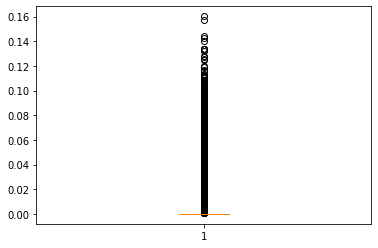

In [17]:
# 計算滲透率
gdf_final['ratio']=gdf_final['會員數']/gdf_final['戶口']
# 設置繪圖時 深透率顯示顏色的上限
gdf_final['ratio2']=gdf_final['ratio']
gdf_final.loc[gdf_final['ratio2']>0.2,'ratio2']=0.2
# 設置繪圖時 深透率顯示顏色的文字
gdf_final['percent']=gdf_final['ratio'].map(lambda x:str(round(x*100,1))+'%')

# 相形圖 看分布
plt.boxplot(gdf_final['ratio'])
plt.plot()

In [24]:
# 匯入門店資料
point=pd.read_excel('./data/店點資訊.xlsx')
point.head(5)

,name,addr,type,lat,lon,location
0,01AA店,台北市士林區,0,25.082606,121.510207,台北市
1,02BB店,新北市新莊區,0,25.059195,121.422794,新北市
2,03CC店,新北市蘆洲區,2,25.081730,121.460254,新北市
3,04DD店,台北市大安區,2,24.930080,121.541591,台北市


# Draw map
## Setting

In [25]:
# 各車站定位
台北車站=[25.047741, 121.517384]
中壢車站=[24.953737, 121.225607]
台中車站=[24.137264, 120.686669]

site=['基隆市','新北市', '台北市','桃園市','新竹縣','新竹市','苗栗縣','台中市','彰化縣','南投縣',
      '雲林縣','嘉義縣','嘉義市','台南市',
      '高雄市','屏東縣','宜蘭縣','花蓮縣','台東縣',
      '澎湖縣','金門縣','連江縣']

site_colors={'基隆市':'#6e5e4c','新北市':'#6e5e4c', '台北市':'#6e5e4c',
            '桃園市':'#968278','新竹縣':'#968278','新竹市':'#968278','苗栗縣':'#968278',
            '台中市':'#6e5e4c','彰化縣':'#6e5e4c','南投縣':'#6e5e4c','澎湖縣':'#6e5e4c','金門縣':'#6e5e4c','連江縣':'#6e5e4c',
            '雲林縣':'#968278','嘉義縣':'#968278','嘉義市':'#968278','台南市':'#968278',
            '高雄市':'#6e5e4c','屏東縣':'#6e5e4c',
            '宜蘭縣':'#968278','花蓮縣':'#968278','台東縣':'#968278'}

#想畫顏色的變數 使用具有上限的變數
variable='ratio2'

#設定色階
gdf_final['id']=gdf_final.index
color=gdf_final.set_index('id')[variable]

high=color.max()
low=color.min()
p=high/8
print(p)

colorscale = branca.colormap.linear.YlOrRd_09.scale(round(low,1), round(high,1))
#colorscale = branca.colormap.linear.YlGnBu_09.scale(low, 0.4)
colorscale


0.020038473869830074


In [26]:
# 顏色 style
def style_function(feature):
    colors = color.get(int(feature['id']), None)
    site_color=site_colors.get(feature['properties']['縣市'])
    return {
        'fillOpacity': 0.5,
        'weight': 1,
        'color':site_color,
        'fillColor': '#fff' if colors is None else colorscale(colors)
    }

In [27]:
# 設定圖例
colormap=colorscale.to_step(index=[0, p*1, p*2, p*3, p*4,p*5,p*6,p*7,p*8])
#colormap.caption ='The Number of Loss Member'
colormap.caption ='Member Penetration Rates'
#colormap.caption ='Average Consumption'

## Draw

In [28]:
# 設定地圖一開始顯示的中心與大小
mm=folium.Map(location=台北車站,zoom_start=12)
# 以迴圈依序畫上不同縣市
for s in site[0:4]:
    folium.GeoJson(
        gdf_final[gdf_final['縣市']==s][['geometry','縣市','行政區','村里','戶口','人口','會員數','ratio','percent']], #選取資料及變數
        name=s, 
        style_function=style_function, #設定顏色function
        # 設定滑鼠游標移過去時顯示的樣式
        highlight_function=lambda x: {'weight':3, 
                                        'color':site_colors.get(x['properties']['縣市']),
                                        'fillOpacity':0.75},
        smooth_factor=2.0,
        tooltip=folium.features.GeoJsonTooltip(fields=['縣市','行政區','村里','戶口','percent'],
                                                  aliases=['縣市','行政區','村里','戶數','滲透率'], 
                                                  labels=True, 
                                                  sticky=True,
                                                  toLocaleString=True
                                                 )
    ).add_to(mm)
# 以顏色邊是不同類型的店點
for i in range(point.shape[0]):
    if point.type[i]==0:
        iframe = IFrame(html=heading3(utf2asc(point.name[i])),width=250,height=50)
        popup = folium.Popup(iframe)
        folium.Marker(location=[point.lat[i], point.lon[i]],
                       popup=popup,
                       icon=folium.Icon(icon='info-sign',
                                        color='orange')).add_to(mm)
    elif point.type[i]==2:
        iframe = IFrame(html=heading3(utf2asc(point.name[i])),width=250,height=50)
        popup = folium.Popup(iframe)
        folium.Marker(location=[point.lat[i], point.lon[i]],
                       popup=popup,
                       icon=folium.Icon(icon='info-sign',
                                        color='pink')).add_to(mm)
    else:  
        iframe = IFrame(html=heading3(utf2asc(point.name[i])),width=250,height=50)
        popup = folium.Popup(iframe)
        folium.Marker(location=[point.lat[i], point.lon[i]],
                       popup=popup,
                       icon=folium.Icon(icon='info-sign',
                                        color='gray')).add_to(mm)

colormap.add_to(mm)

folium.LayerControl().add_to(mm)

In [29]:
mm

## Save file

In [30]:
mm.save('result.html')